In [40]:
import os

In [41]:
print(os.getcwd())

/home/maciej/Documents/Thesis/MThesis


In [42]:
import numpy as np 
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import scipy as sc
import plotly
import plotly.express as px
from scipy.signal import correlate, correlation_lags, correlate2d
import plotly.graph_objects as go
from scipy import stats as scst
import numba as nb 

# Data Imports

In [43]:
# Frame Times (seconds)

frame_t_df = pd.read_csv("Data/frameTimes.csv", sep=',',header=None)
frame_t_df = frame_t_df.T
frame_t = frame_t_df.to_numpy()
frame_t = frame_t[:,0]

print(f'var frame_t shape:{frame_t.shape} ')

var frame_t shape:(51225,) 


In [44]:
# Stimulation IDs

stimIDs_df = pd.read_csv("Data/stimIDs.csv", sep=',',header=None)
stimIDs_df = stimIDs_df.T
stimIDs = stimIDs_df.to_numpy()
stimIDs = stimIDs[:,0]
print(f'var frame_t shape:{stimIDs.shape} ')

var frame_t shape:(560,) 


In [45]:
# Time (seconds) of stimulus onset

StimOn_df = pd.read_csv("Data/stimOnsetTimes.csv", sep=',',header=None)
StimOn_df = StimOn_df.T
StimOn = StimOn_df.to_numpy()
StimOn = StimOn[:,0]
print(f'var frame_t shape:{StimOn.shape} ')

var frame_t shape:(560,) 


In [46]:
# Time (seconds) of stimulus offset

StimOff_df = pd.read_csv("Data/stimOffsetTimes.csv", sep=',',header=None)
StimOff_df = StimOff_df.T
StimOff = StimOff_df.to_numpy()
StimOff = StimOff[:,0]
print(f'var frame_t shape:{StimOff.shape} ')

var frame_t shape:(560,) 


In [47]:
relStimOn = []
relStimOff = []
#StimOn
#StimOff
# frame_t
count_on = 0
count_off = 0
for i in range(0, len(frame_t)-1):
    if frame_t[i] == StimOn[count_on]:
        relStimOn.append(count_on)
        count_on+=1
    if frame_t[i] == StimOff[count_off]:
        relStimOn.append(count_off)
        count_off+=1


In [48]:
# Time (seconds) of stimulus offset in
StimOff_df = pd.read_csv("Data/stimOffsetTimes.csv", sep=',',header=None)
StimOff_df = StimOff_df.T
StimOff = StimOff_df.to_numpy()
StimOff = StimOff[:,0]
print(f'var frame_t shape:{StimOff.shape} ')

var frame_t shape:(560,) 


In [49]:
# Fluoresence Data Full set, Suite2p
FluoData = np.load("Data/Suite2p/plane0/F.npy")

In [50]:
# ROI's array identified as valid spines 
fDataGood = np.load("Data/Suite2p/plane0/iscell.npy")

In [51]:
# Generate mask where indicies correspond to valid spines

validity_mask = fDataGood[:, 0] == 1.0
validity_mask.shape

(476,)

In [52]:
# Apply validity mask to the Fluoresence Data to filter for valid spines
validity_mask = fDataGood[:, 0] == 1.0

# Filter the first array using the validity mask
filtered_data = FluoData[validity_mask, :]

# Check the shape of the filtered data
print(filtered_data.shape)

(142, 51225)


In [53]:
zipped = []
for i in range(0, filtered_data.shape[0]):
    zipped.append([filtered_data[i], frame_t])

In [54]:
# Dataframe to use for later
full_pd = (pd.DataFrame(FluoData)).T

In [55]:
# Dataframe to use for later
filtered_pd = (pd.DataFrame(filtered_data)).T

In [56]:
1/ np.mean((np.diff(frame_t)[:100]))

np.float64(30.030030030030026)

In [57]:
1/0.034

29.41176470588235

# Quick Visualisation

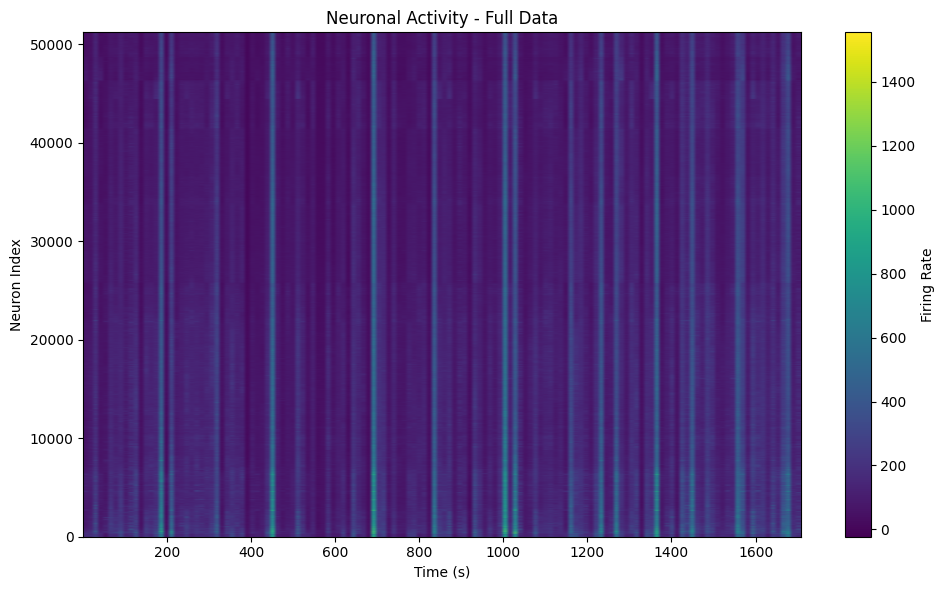

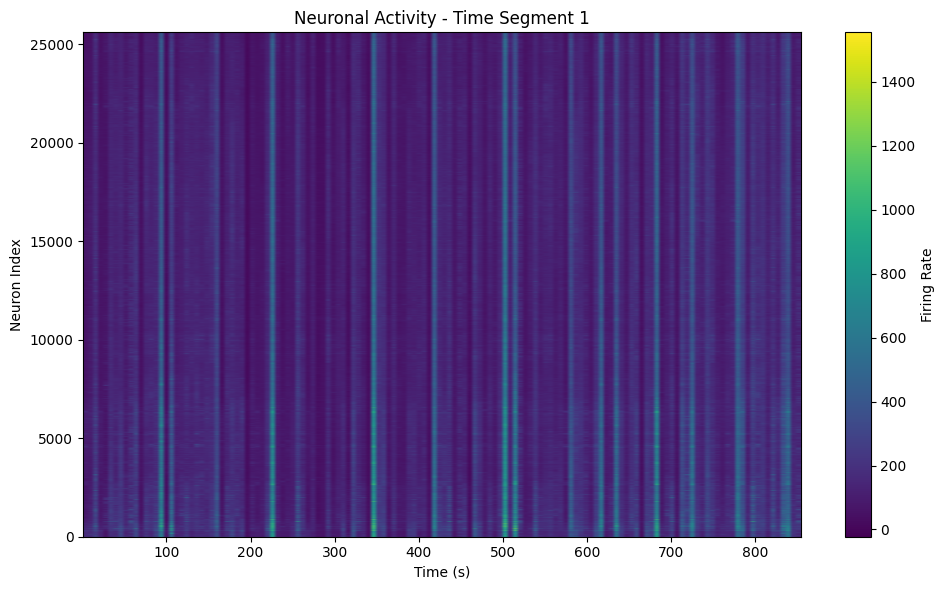

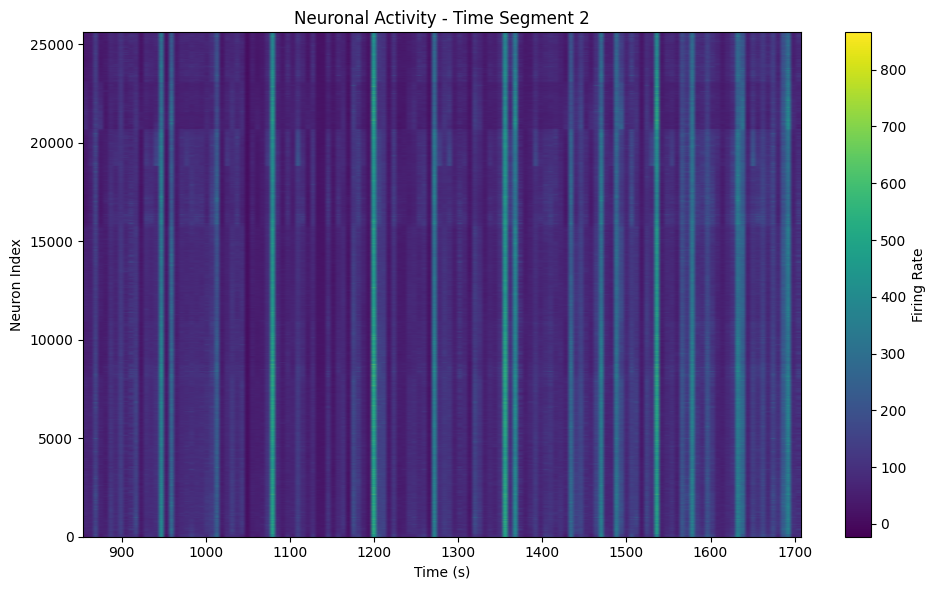

In [58]:
import matplotlib.pyplot as plt
import numpy as np

# Matplotlib function to plot a heatmap

def plot_heatmap(data, time_array, title):
    """Plots a heatmap of neuronal activity."""
    plt.figure(figsize=(10, 6))

    # Transpose the data if necessary to have neurons on the y-axis and time on the x-axis
    if data.shape[0] != len(time_array) and data.shape[1] == len(time_array):
        data = data.T  # Transpose the data

    plt.imshow(data, aspect='auto', origin='lower', extent=[time_array[0], time_array[-1], 0, data.shape[0]], cmap='viridis')
    plt.xlabel('Time (s)')
    plt.ylabel('Neuron Index')
    plt.title(title)
    plt.colorbar(label='Firing Rate')
    plt.tight_layout()
    plt.show()


# Example usage (assuming filtered_data is (142, 52000) and frame_t is (52000,)):

plot_heatmap(filtered_data, frame_t, 'Neuronal Activity - Full Data')

# Example usage (for time segment 1):
time_segment_1_data = filtered_data[:, :len(frame_t)//2]  # First half of the data
time_segment_1 = frame_t[:len(frame_t)//2]
plot_heatmap(time_segment_1_data, time_segment_1, 'Neuronal Activity - Time Segment 1')

# Example usage (for time segment 2):
time_segment_2_data = filtered_data[:, len(frame_t)//2:]  # Second half of the data
time_segment_2 = frame_t[len(frame_t)//2:]
plot_heatmap(time_segment_2_data, time_segment_2, 'Neuronal Activity - Time Segment 2')

<Axes: >

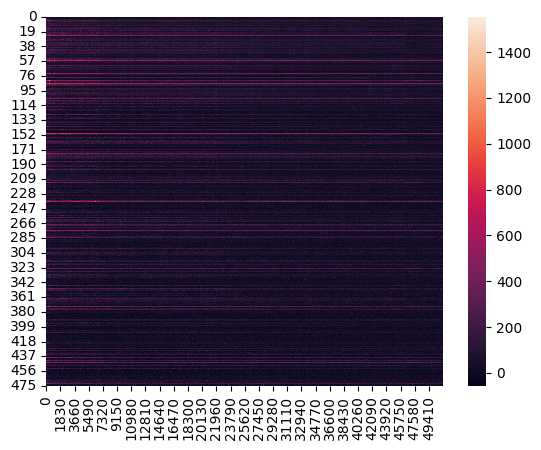

In [59]:
sns.heatmap(FluoData)

<Axes: >

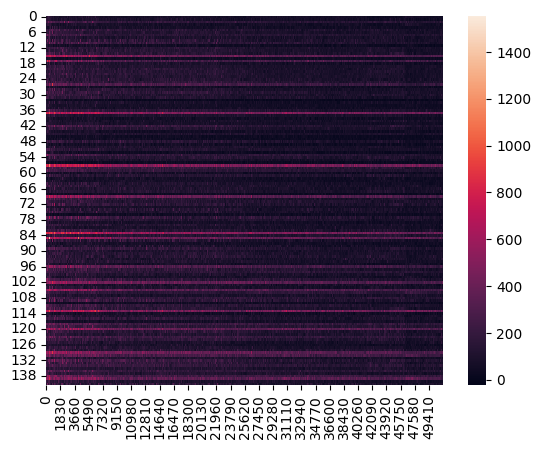

In [60]:
sns.heatmap(filtered_data)

## Some visualisation and pre-processing

In [61]:
subset = filtered_data[0:10, :1000]

In [62]:
normz_sub = scst.zscore(subset, axis=0)
filtered_data_z = scst.zscore(filtered_data, axis=0)

In [63]:
normz_sub.shape

(10, 1000)

In [64]:
import plotly.graph_objects as go
import numpy as np



# Number of neurons to plot
neurons_to_plot = 3

# Create the figure
fig = go.Figure()

# Plot neural activity
for i in range(neurons_to_plot):
    fig.add_trace(go.Scatter(x=frame_t[:1000], y=normz_sub[i][:1000], mode='lines', opacity=0.5, name=f'Neuron {i+1}'))

# Plot stimulus regions and lines
for onset, offset in zip(StimOn[:10], StimOff[:10]):
    # Shaded region
    fig.add_trace(go.Scatter(
        x=[onset, offset, offset, onset], 
        y=[np.min(normz_sub[:neurons_to_plot,:1000]), np.min(normz_sub[:neurons_to_plot,:1000]), np.max(normz_sub[:neurons_to_plot,:1000]), np.max(normz_sub[:neurons_to_plot,:1000])], 
        mode='lines',
        fill="toself",
        fillcolor="red",
        opacity=0.2,  
        line=dict(width=0),  
        name="Stimulus Period",
        showlegend = False if (onset != StimOn[0]) else True 
    ))
    # Onset line
    fig.add_trace(go.Scatter(x=[onset, onset], y=[np.min(normz_sub[:neurons_to_plot,:1000]), np.max(normz_sub[:neurons_to_plot,:1000])], mode='lines', line=dict(color='red', dash='dash', width=1), opacity=0.8, showlegend=False)) 
    # Offset line
    fig.add_trace(go.Scatter(x=[offset, offset], y=[np.min(normz_sub[:neurons_to_plot,:1000]), np.max(normz_sub[:neurons_to_plot,:1000])], mode='lines', line=dict(color='blue', dash='dash', width=1), opacity=0.8, showlegend=False)) 


# Update layout
fig.update_layout(
    title='Neuronal Firing Rates with Stimulus Periods',
    xaxis_title='Time (s)',
    yaxis_title='Firing Rate (normalized)'
)

fig.show()

In [65]:
avg_filt = scst.zscore(np.average(filtered_data,axis=0))
Sumemd_filt = np.sum(filtered_data, axis=0)

In [66]:
frame_t

array([1.0070e+00, 1.0400e+00, 1.0730e+00, ..., 1.7071e+03, 1.7071e+03,
       1.7071e+03])

In [67]:
px.line(x=range(0, len(avg_filt)), y=avg_filt)

In [68]:
filtered_data.shape

(142, 51225)

In [ ]:
import plotly.graph_objects as go
import numpy as np



# Number of neurons to plot
num_neurons_to_plot = 6
indicies = [ i for i in range(0, filtered_data.shape[0])]
rand_indicies = np.random.choice(indicies, num_neurons_to_plot,replace=False)
neurons_to_plot = filtered_data_z[rand_indicies]
num_stims = 40

#Elements to plot
t = 5000
# Create the figure
fig = go.Figure()

# Plot neural activity
for i in range(num_neurons_to_plot):
    fig.add_trace(go.Scatter(x=frame_t[:t], y=filtered_data_z[i][:t], mode='lines', opacity=0.5, name=f'Neuron {i+1}'))
fig.add_trace( go.Scatter(x=frame_t[:t], y = avg_filt[:t], mode='lines',name="Avg"  ) )
# Plot stimulus regions and lines
for onset, offset in zip(StimOn[:num_stims], StimOff[:num_stims]):
    # Shaded region
    fig.add_trace(go.Scatter(
        x=[onset, offset, offset, onset], 
        y=[np.min(filtered_data_z[:num_neurons_to_plot,:t]), np.min(filtered_data_z[:num_neurons_to_plot,:t]), np.max(avg_filt[:t]), np.max(avg_filt[:t])], 
        mode='lines',
        fill="toself",
        fillcolor="red",
        opacity=0.2,  
        line=dict(width=0),  
        name="Stimulus Period",
        showlegend = False if (onset != StimOn[0]) else True 
    ))
    # Onset line
    fig.add_trace(go.Scatter(x=[onset, onset], y=[np.min(filtered_data_z[:num_neurons_to_plot,:t]), np.max(avg_filt[:t])], mode='lines', line=dict(color='red', dash='dash', width=1), opacity=0.8, showlegend=False)) 
    # Offset line
    fig.add_trace(go.Scatter(x=[offset, offset], y=[np.min(filtered_data_z[:num_neurons_to_plot,:t]), np.max(avg_filt[:t])], mode='lines', line=dict(color='blue', dash='dash', width=1), opacity=0.8, showlegend=False)) 


# Update layout
fig.update_layout(
    title='Neuronal Firing Rates with Stimulus Periods',
    xaxis_title='Time (s)',
    yaxis_title='Firing Rate (normalized)'
)

fig.show()

Filtering steps

In [71]:
import numpy as np

def filter_stimuli(StimOn, StimOff, frame_t_subsection, leeway_time):
    """Filters StimOn and StimOff arrays to keep only values within a 
       specified time range (with leeway).

    Args:
        StimOn (np.ndarray): Array of stimulus onset times.
        StimOff (np.ndarray): Array of stimulus offset times.
        frame_t_subsection (np.ndarray): Subsection of the frame_t array.
        leeway_time (float): Time leeway (in seconds) before and after the 
                             subsection's start and end times.

    Returns:
        tuple: A tuple containing the filtered StimOn and StimOff arrays.
    """

    start_time = frame_t_subsection[0] - leeway_time
    end_time = frame_t_subsection[-1] + leeway_time

    filtered_StimOn = StimOn[(StimOn >= start_time) & (StimOn <= end_time)]
    filtered_StimOff = StimOff[(StimOff >= start_time) & (StimOff <= end_time)]

    return filtered_StimOn, filtered_StimOff



# Example usage:
frame_t_subsection = frame_t[-2000:]  # Example subsection
leeway_time = 0.05  # 50 ms leeway

filtered_StimOn, filtered_StimOff = filter_stimuli(StimOn, StimOff, frame_t_subsection, leeway_time)

print("Filtered StimOn:", filtered_StimOn)
print("Filtered StimOff:", filtered_StimOff)

# Now use filtered_StimOn and filtered_StimOff for your plotting or analysis.

Filtered StimOn: [1641.8 1644.8 1647.8 1650.9 1653.9 1656.9 1659.9 1662.9 1665.9 1668.9
 1671.9 1674.9 1677.9 1680.9 1683.9 1687.  1690.  1693.  1696.  1699. ]
Filtered StimOff: [1642.8 1645.8 1648.8 1651.8 1654.8 1657.9 1660.9 1663.9 1666.9 1669.9
 1672.9 1675.9 1678.9 1681.9 1684.9 1688.  1691.  1694.  1697.  1700. ]


In [133]:
import plotly.graph_objects as go
import numpy as np
import scipy.stats as scst

def plot_neuronal_activity(filtered_data, frame_t, StimOn, StimOff, mode='avg', time_range="full", z_score=True):
    """Plots neuronal activity with stimulus markers."""

    # 1. Time Range Selection:
    if time_range == "full":
        start_index = 0
        end_index = len(frame_t)
    elif isinstance(time_range, tuple):
        start_time, end_time = time_range
        start_index = np.argmin(np.abs(frame_t - start_time))
        end_index = np.argmin(np.abs(frame_t - end_time)) + 1
    elif isinstance(time_range, int):  # Last N samples
        start_index = len(frame_t) - time_range
        end_index = len(frame_t)
    else:
        raise ValueError("Invalid time_range. Must be 'full', a tuple, or an integer.")

    time_segment = frame_t[start_index:end_index]
    data_segment = filtered_data[:, start_index:end_index]

    # 2. Calculate Average/Summed Activity:
    if mode == 'avg':
        activity = np.mean(data_segment, axis=0)
    elif mode == 'sum':
        activity = np.sum(data_segment, axis=0)
    else:
        raise ValueError("Invalid mode. Must be 'avg' or 'sum'.")

    # 3. Z-score Normalization (Optional):
    if z_score:
        activity = scst.zscore(activity)

    # 4. Filter Stimuli within Time Range (Corrected):
    filtered_StimOn = [onset for onset in StimOn if time_segment[0] <= onset <= time_segment[-1]]
    filtered_StimOff = [offset for offset in StimOff if time_segment[0] <= offset <= time_segment[-1]]

    # 5. Plotting:
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=time_segment, y=activity, mode='lines', name='Average Activity'))

    for onset, offset in zip(filtered_StimOn, filtered_StimOff):
        min_y = np.min(activity) if len(activity) > 0 else 0 #Check if array is empty
        max_y = np.max(activity) if len(activity) > 0 else 1 #Check if array is empty

        fig.add_trace(go.Scatter(
            x=[onset, offset, offset, onset],
            y=[min_y, min_y, max_y, max_y],
            mode='lines',
            fill="toself",
            fillcolor="red",  # Shaded region
            opacity=0.2,
            line=dict(width=0),  # No border for filled region
            name="Stimulus Period",
            showlegend=False if (onset != StimOn[0]) else True
        ))
        fig.add_trace(go.Scatter(x=[onset, onset], y=[min_y, max_y],
                         mode='lines', line=dict(color='red', dash='dash', width=1), opacity=0.8, showlegend=False))  # Onset line
        fig.add_trace(go.Scatter(x=[offset, offset], y=[min_y, max_y],
                         mode='lines', line=dict(color='blue', dash='dash', width=1), opacity=0.8, showlegend=False))  # Offset line


    fig.update_layout(
        title='Average Neuronal Firing Rate with Stimulus Periods',
        xaxis_title='Time (s)',
        yaxis_title='Firing Rate (Z-Score Normalized)' if z_score else 'Firing Rate'
    )

    return fig

# Example usage:
fig = plot_neuronal_activity(filtered_data, frame_t, StimOn, StimOff, mode='avg', time_range="full", z_score=True)
fig.show()


## Fourier Transform (half working)

In [73]:
ft_2 = frame_t.copy()

In [74]:
1/0.035

28.57142857142857

In [75]:
ft_2 = np.diff(ft_2)
sampling = 1/np.mean(ft_2)
print(sampling)

30.024154603529823


In [76]:
import scipy.signal as signal

def filter_low_frequencies(signal_data, fs, cutoff_freq):
    """Filters low frequencies from a signal using FFT."""

    N = len(signal_data)  # Number of samples in the signal
    T = 1/fs  # Time step (duration of each sample)

    # 1. Windowing (Reduces Spectral Leakage):
   # window = signal.hann(N)  # Creates a Hann window
   # windowed_signal = signal_data * window  # Applies the window to the signal

    # 2. FFT:
    yf = np.fft.fft(signal_data)  # Computes the Discrete Fourier Transform (FFT)

    psd = yf * np.conj(yf)
    freq = 1 / (N*fs) * np.arange(N)

    # 3. Frequency Vector (For Plotting and Understanding):
    xf = np.fft.fftfreq(N, T)[:N//2]  # Positive frequencies only (signal is symmetric)

    # 4. Filtering:
    yf_filtered = yf.copy()  # Create a copy to avoid modifying the original FFT
    yf_filtered[np.abs(xf) < cutoff_freq] = 0  # Set low frequencies to zero

    # 5. IFFT:
    filtered_signal = np.fft.ifft(yf_filtered)  # Inverse FFT

    return np.real(filtered_signal)  # Take the real part

/home/maciej/Documents/Thesis/MThesis/venv/lib/python3.12/site-packages/matplotlib/cbook.py:1709: ComplexWarning:

Casting complex values to real discards the imaginary part

/home/maciej/Documents/Thesis/MThesis/venv/lib/python3.12/site-packages/matplotlib/cbook.py:1345: ComplexWarning:

Casting complex values to real discards the imaginary part



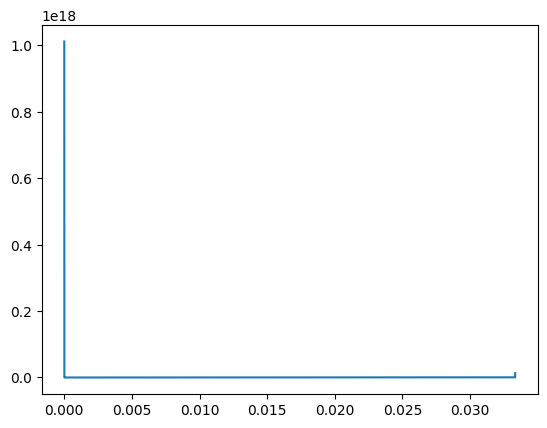

In [77]:
signal_data = np.sum(filtered_data, axis=0)
fs = 30
N = len(signal_data)  # Number of samples in the signal
T = 1/fs  # Time step (duration of each sample)

# 1. Windowing (Reduces Spectral Leakage):
# window = signal.hann(N)  # Creates a Hann window
# windowed_signal = signal_data * window  # Applies the window to the signal

# 2. FFT:
yf = np.fft.fft(signal_data,N)  # Computes the Discrete Fourier Transform (FFT)

psd = yf * np.conj(yf)
freq = 1 / (N*fs) * np.arange(N)

plt.plot(freq, psd)

In [78]:
frame_t

array([1.0070e+00, 1.0400e+00, 1.0730e+00, ..., 1.7071e+03, 1.7071e+03,
       1.7071e+03])

In [79]:
import numpy as np

def segment_data(filt_data, frame_t, StimOn, StimOff, pre_stim_samples=10, post_stim_samples=10):
    """Segments neuronal data around stimulus periods.

    Args:
        filt_data (np.ndarray): Neuronal firing rate data (neurons x time).
        frame_t (np.ndarray): Time array.
        StimOn (np.ndarray): Stimulus onset times.
        StimOff (np.ndarray): Stimulus offset times.
        pre_stim_samples (int, optional): Number of samples to include before stimulus onset. Defaults to 5.
        post_stim_samples (int, optional): Number of samples to include after stimulus offset. Defaults to 5.

    Returns:
        dict: A dictionary where keys are stimulus indices and values are 
              dictionaries containing the segmented data and corresponding time array.
              Returns an empty dictionary if no valid segments are found.
    """

    segmented_data = {}

    for i, (onset, offset) in enumerate(zip(StimOn, StimOff)):
        # Find the indices corresponding to onset and offset times in frame_t
        onset_index = np.argmin(np.abs(frame_t - onset))
        offset_index = np.argmin(np.abs(frame_t - offset))

        # Calculate start and end indices for the segment
        start_index = max(0, onset_index - pre_stim_samples)  # Ensure start is not negative
        end_index = min(filt_data.shape[1] - 1, offset_index + post_stim_samples)  # Ensure end is within data bounds

        # Extract the segment of data
        segment = filt_data[:, start_index:end_index]

        # Extract the corresponding time segment
        segment_time = frame_t[start_index:end_index]

        if segment.size > 0: # Check to make sure we have a valid segment
            segmented_data[i] = {'data': segment, 'time': segment_time}
        else:
            print(f"Warning: No valid segment found for stimulus {i}. Skipping.")

    return segmented_data



# Example usage:
segmented_data = segment_data(filtered_data, frame_t, StimOn, StimOff, pre_stim_samples=10, post_stim_samples=10)

# Accessing the segmented data:
# for i, segment_info in segmented_data.items():
#     data = segment_info['data']  # Shape: (neurons, segment_length)
#     time = segment_info['time']  # Shape: (segment_length,)

#     print(f"Segment {i}:")
#     print("Data shape:", data.shape)
#     print("Time shape:", time.shape)
#     # Now you can analyze the 'data' and 'time' for each segment

#     # Example: Plotting a segment
#     import plotly.graph_objects as go
#     fig = go.Figure()
#     for neuron in range(data.shape[0]):  # Loop through neurons
#         fig.add_trace(go.Scatter(x=time, y=data[neuron, :], mode='lines', name=f'Neuron {neuron + 1}'))
#     fig.update_layout(title=f"Segment {i} Activity", xaxis_title="Time (s)", yaxis_title="Firing Rate")
#     fig.show()

In [80]:
import numpy as np

def segment_data_2(filt_data, frame_t, StimOn, StimOff, pre_stim_samples=5, time_to_next_stim=10):
    """Segments neuronal data around stimulus periods, leading up to a 
       specified time before the next stimulus.

    Args:
        filt_data (np.ndarray): Neuronal firing rate data (neurons x time).
        frame_t (np.ndarray): Time array.
        StimOn (np.ndarray): Stimulus onset times.
        StimOff (np.ndarray): Stimulus offset times.
        pre_stim_samples (int, optional): Number of samples to include before stimulus onset. Defaults to 5.
        time_to_next_stim (int, optional): Time (in samples) before the *next* stimulus 
                                           to end the current segment. Defaults to 10.

    Returns:
        dict: A dictionary where keys are stimulus indices and values are 
              dictionaries containing the segmented data, corresponding time array,
              and the actual StimOn and StimOff times for that segment.
              Returns an empty dictionary if no valid segments are found.
    """

    segmented_data = {}

    for i, (onset, offset) in enumerate(zip(StimOn, StimOff)):
        onset_index = np.argmin(np.abs(frame_t - onset))
        offset_index = np.argmin(np.abs(frame_t - offset))

        start_index = max(0, onset_index - pre_stim_samples)

        # Find the index for the end of the segment based on time_to_next_stim
        if i < len(StimOn) - 1:  # Check if it's not the last stimulus
            next_stim_time = StimOn[i + 1]
            end_time = next_stim_time - frame_t[0] # Time relative to the start of the recording
            end_index = np.argmin(np.abs(frame_t - (offset + (end_time - offset))))

            # end_index = np.argmin(np.abs(frame_t - (next_stim_time - time_to_next_stim)))
        else:  # Last stimulus, go to the end of the data
            end_index = filt_data.shape[1] - 1  # Or some other appropriate end condition

        segment = filt_data[:, start_index:end_index]
        segment_time = frame_t[start_index:end_index]

        if segment.size > 0:
            segmented_data[i] = {
                'data': segment,
                'time': segment_time,
                'stim_on': onset,  # Store the actual StimOn time
                'stim_off': offset,  # Store the actual StimOff time
            }
        else:
            print(f"Warning: No valid segment found for stimulus {i}. Skipping.")

    return segmented_data



# Example usage (plotting with StimOn/Off lines):

segmented_data = segment_data_2(filtered_data, frame_t, StimOn, StimOff, pre_stim_samples=10, time_to_next_stim=15)



In [81]:
segmented_data.items()

dict_items([(0, {'data': array([[212.02582 , 222.92288 , 218.77812 , ..., 139.91313 , 192.7732  ,
        174.84016 ],
       [195.4506  , 135.76436 , 161.00778 , ..., 163.1095  , 168.93826 ,
        138.99632 ],
       [418.16324 , 417.06766 , 424.3347  , ..., 280.5966  , 292.68076 ,
        210.64995 ],
       ...,
       [825.25073 , 690.6406  , 767.7738  , ..., 696.021   , 648.7172  ,
        650.9841  ],
       [286.61588 , 310.10852 , 268.9592  , ..., 182.6812  , 163.11557 ,
        256.75552 ],
       [161.06877 , 122.315056, 110.53365 , ..., 126.969315, 187.01337 ,
        131.50421 ]], dtype=float32), 'time': array([11.065, 11.098, 11.132, 11.165, 11.198, 11.231, 11.265, 11.298,
       11.331, 11.365, 11.398, 11.431, 11.465, 11.498, 11.531, 11.565,
       11.598, 11.631, 11.664, 11.698, 11.731, 11.764, 11.798, 11.831,
       11.864, 11.898, 11.931, 11.964, 11.998, 12.031, 12.064, 12.097,
       12.131, 12.164, 12.197, 12.231, 12.264, 12.297, 12.331, 12.364,
       12.397, 12.4

In [82]:
max_plot = 2
count = 0
for i, segInfo in segmented_data.items():
    if count == max_plot:
        break
    data = segInfo['data']
    time = segInfo['time']
    stim_on = segInfo['stim_on']  # Retrieve StimOn
    stim_off = segInfo['stim_off']  # Retrieve StimOff

    fig = go.Figure()
    for neuron in range(data.shape[0]):
        fig.add_trace(go.Scatter(x=time, y=data[neuron, :], mode='lines', name=f'Neuron {neuron + 1}'))

    fig.add_trace(go.Scatter(x=[stim_on, stim_on], y=[np.min(data), np.max(data)], mode='lines', line=dict(color='red', dash='dash', width=1), name="Stim On", showlegend=False))
    fig.add_trace(go.Scatter(x=[stim_off, stim_off], y=[np.min(data), np.max(data)], mode='lines', line=dict(color='blue', dash='dash', width=1), name="Stim Off", showlegend=False))

    fig.update_layout(title=f"Segment {i} Activity - Individual Neurons", xaxis_title="Time (s)", yaxis_title="Firing Rate")
    fig.show()

    count+=1

In [83]:
Summed_segm = {}  # Create a *new* dictionary

for i, segment in segmented_data.items():
    Summed_segm[i] = {  # Store in the *new* dictionary
        'data': np.sum(segment['data'], axis=0),  # Summed data
        'time': segment['time'],
        'stim_on': segment['stim_on'],
        'stim_off': segment['stim_off'],
    }

In [84]:
def segment_data_multiple_stimuli(filt_data, frame_t, StimOn, StimOff, pre_stim_samples=5, post_stim_samples=5, num_stimuli_per_segment=1):  # New parameter
    """Segments neuronal data around multiple stimulus periods.

    Args:
        filt_data (np.ndarray): Neuronal firing rate data (neurons x time).
        frame_t (np.ndarray): Time array.
        StimOn (np.ndarray): Stimulus onset times.
        StimOff (np.ndarray): Stimulus offset times.
        pre_stim_samples (int, optional): Samples before the first StimOn.
        post_stim_samples (int, optional): Samples after the last StimOff.
        num_stimuli_per_segment (int, optional): Number of StimOn/Off pairs per segment.

    Returns:
        dict: Segmented data (keys are segment indices, values are dictionaries
              containing 'data', 'time', 'stim_on', 'stim_off').
              Returns an empty dictionary if no valid segments are found.
    """

    segmented_data = {}
    segment_index = 0

    for i in range(0, len(StimOn), num_stimuli_per_segment):
        # Determine the stimuli for the current segment
        segment_stim_on = StimOn[i:min(i + num_stimuli_per_segment, len(StimOn))]
        segment_stim_off = StimOff[i:min(i + num_stimuli_per_segment, len(StimOff))]

        # Calculate the start and end times for the segment
        first_onset_index = np.argmin(np.abs(frame_t - segment_stim_on[0]))
        last_offset_index = np.argmin(np.abs(frame_t - segment_stim_off[-1]))

        start_index = max(0, first_onset_index - pre_stim_samples)
        end_index = min(filt_data.shape[1] - 1, last_offset_index + post_stim_samples)

        segment_data = filt_data[:, start_index:end_index]
        segment_time = frame_t[start_index:end_index]

        if segment_data.size > 0:
            segmented_data[segment_index] = {
                'data': segment_data,
                'time': segment_time,
                'stim_on': segment_stim_on,  # Store the StimOn times for the segment
                'stim_off': segment_stim_off,  # Store the StimOff times for the segment
            }
            segment_index += 1
        else:
            print(f"Warning: No valid segment found starting at stimulus {i}. Skipping.")

    return segmented_data


In [85]:
three_segs =  segment_data_multiple_stimuli(filtered_data, frame_t, StimOn, StimOff, pre_stim_samples=20, post_stim_samples=20, num_stimuli_per_segment=3)

In [86]:
three_segs[0]

{'data': array([[207.26378 , 204.79703 , 220.79077 , ..., 164.51903 , 141.29466 ,
         138.95593 ],
        [154.5574  ,  91.510826, 169.64848 , ..., 145.65997 , 164.42314 ,
         188.60527 ],
        [329.71494 , 336.00897 , 429.12366 , ..., 283.9589  , 360.99    ,
         366.81934 ],
        ...,
        [496.36075 , 500.59366 , 549.91656 , ..., 570.05994 , 576.2282  ,
         468.81964 ],
        [181.45963 , 183.55042 , 266.89087 , ..., 186.47188 , 165.49777 ,
         147.99152 ],
        [ 99.27098 , 133.42137 , 181.18353 , ..., 166.94864 , 171.64708 ,
         237.87648 ]], dtype=float32),
 'time': array([10.732, 10.765, 10.799, 10.832, 10.865, 10.898, 10.932, 10.965,
        10.998, 11.032, 11.065, 11.098, 11.132, 11.165, 11.198, 11.231,
        11.265, 11.298, 11.331, 11.365, 11.398, 11.431, 11.465, 11.498,
        11.531, 11.565, 11.598, 11.631, 11.664, 11.698, 11.731, 11.764,
        11.798, 11.831, 11.864, 11.898, 11.931, 11.964, 11.998, 12.031,
        12.064, 12

In [87]:
example = three_segs[2]

In [88]:
long_sum_segm = {}  # Create a *new* dictionary

for i, segment in three_segs.items():
    long_sum_segm[i] = {  # Store in the *new* dictionary
        'data': np.sum(segment['data'], axis=0),  # Summed data
        'time': segment['time'],
        'stim_on': segment['stim_on'],
        'stim_off': segment['stim_off'],
    }

# The good stuff 

Remove contributions of correlating neuron to the summation

Plot heatmap, x= Lags, y = Neurons heat = degree of correlation

in terms of peaks of cross correlation: 
- Try Centre of Mass instead of highest peak


average response of each spine to stimulus (half and half the data) \\
Order it by Lags of response after the stimulus onset 

In [89]:
stim_on

np.float64(14.443)

In [90]:
nord_B = np.sum(scst.zscore(filtered_data), axis=0)
nord_A = scst.zscore(np.sum(filtered_data, axis=0))

In [91]:
nord_B.shape

(51225,)

In [92]:
px.line(nord_A)

In [93]:
filtered_data.shape

(142, 51225)

In [94]:
int(51225/2)

25612

In [95]:
filt_split_1, filt_split_2 = filtered_data[:,:25612], filtered_data[:,25612:]

In [96]:
sum_split_1, sum_split_2 = nord_B[:25612], nord_B[25612:]

In [97]:
def limited_cross_correlation(signal1, signal2, max_lag_samples):

    correlation = correlate(signal1, signal2)
    lags = correlation_lags(signal1.size, signal2.size)

    valid_lag_indices = np.where(np.abs(lags) <= max_lag_samples)[0]
    correlation_limited = correlation[valid_lag_indices]
    lags_limited = lags[valid_lag_indices]

    return correlation_limited, lags_limited

In [98]:
test = np.array([np.sin(i) for i in range(0,20)])
test2 = np.array([np.sin(i-2)  for i in range(0,20)])

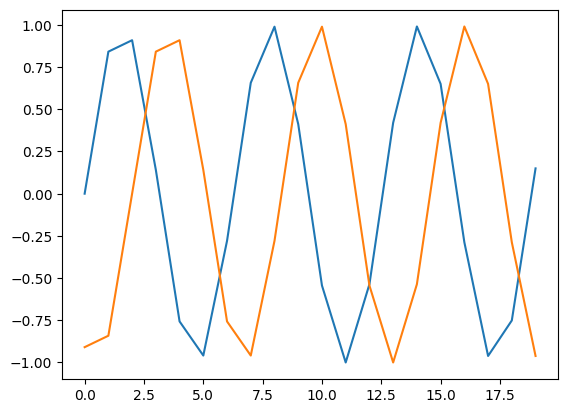

In [99]:
plt.plot(test)
plt.plot(test2)

Text(0, 0.5, 'Correlation')

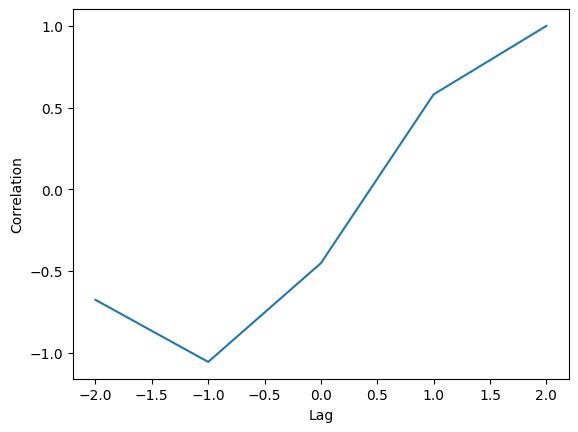

In [100]:
corr, lags = limited_cross_correlation(test2, test,2)
corr /= np.max(corr)
plt.plot(lags, corr)
plt.xlabel('Lag')
plt.ylabel('Correlation')

In [101]:
def get_correlation_arrays(nord_B, neuron_signal, sampling_rate = 0.032, max_lag_seconds = 0.5):
    
    fs = 1.0/sampling_rate #Sampling rate

    
    max_lag_samples = int(max_lag_seconds * fs)  # Convert to samples

    correlation_neuron = []
    lags_neuron = []

    for i in range(filtered_data.shape[0]):     # Iterate through each neurons neurons
        neuron_signal = filtered_data[i,:]      # Get individual neuron signal
        corr, lags = limited_cross_correlation(neuron_signal, nord_B, max_lag_samples) # Run limited XCorr
#remove later
        
        corr /= np.max(np.abs(corr))  # Normalize correlation

        correlation_neuron.append(corr)
        lags_neuron.append(lags)

    correlation_neuron = np.array(correlation_neuron) #Convert to numpy array
    lags_neuron = np.array(lags_neuron) 

    return correlation_neuron, lags_neuron


In [102]:
def sort_lags (correlation_neuron, lags_neuron):

    #Sort the max_lags, and keep track of which neuron is which

    num_neurons = len(correlation_neuron)
    max_lags = np.zeros(num_neurons)  # Initialize NumPy array
    neuron_lag_order = np.arange(num_neurons)  # Keep track of original order

    for i in range(num_neurons):
        max_lag_index = np.argmax(np.abs(correlation_neuron[i]))
        max_lag = lags_neuron[i][max_lag_index]
        max_lags[i] = max_lag

    # Indicies which would sort the max_lags 
    sorted_indices = np.argsort(max_lags)

    # Sort max_lags and neuron_lag_order using the indices:
    max_lags_sorted = max_lags[sorted_indices]
    sorted_neuron_order = neuron_lag_order[sorted_indices]  

    return max_lags_sorted, sorted_neuron_order

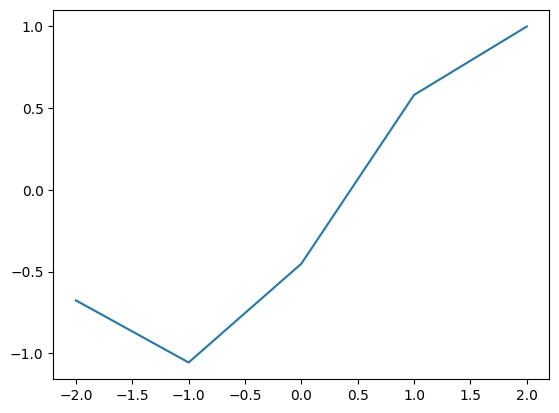

In [103]:
plt.plot(lags,corr)

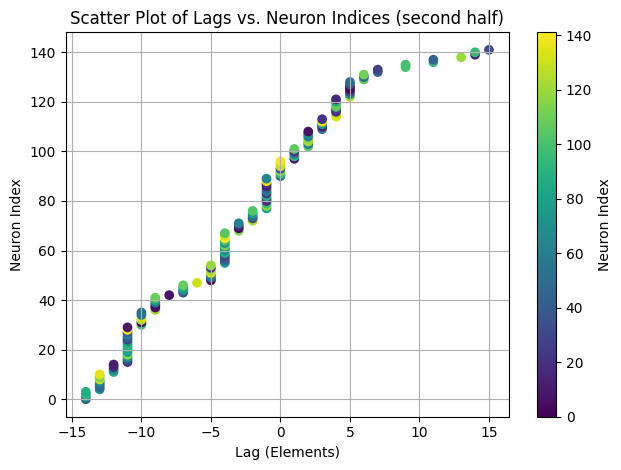

In [104]:
corr, lags = get_correlation_arrays(sum_split_1, filt_split_1)
max_lags_1, rel_neur_1 = sort_lags(corr, lags)

plt.scatter(max_lags_1, range(0,len(max_lags_1)), c=rel_neur_1, cmap='viridis')  # Use neuron_indices for colors
plt.xlabel('Lag (Elements)')
plt.ylabel('Neuron Index')
plt.title('Scatter Plot of Lags vs. Neuron Indices (second half)')
plt.colorbar(label='Neuron Index')  # Add a colorbar for reference
plt.grid(True)
plt.tight_layout()
plt.show()

In [105]:
corr, lags = get_correlation_arrays(sum_split_2, filt_split_2, max_lag_seconds=5)
max_lags_2, rel_neur_2 = sort_lags(corr, lags)

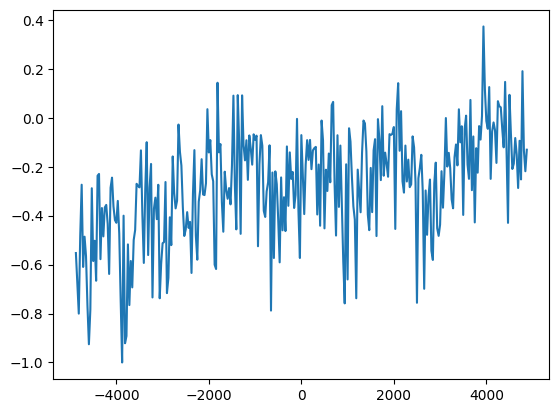

In [106]:
dt = 1/32
lags_ms = lags[0] * dt * 1000

plt.plot(lags_ms,corr[0])

In [107]:
max_1 = max_lags_1[rel_neur_1]
max_2 = max_lags_2[rel_neur_2]

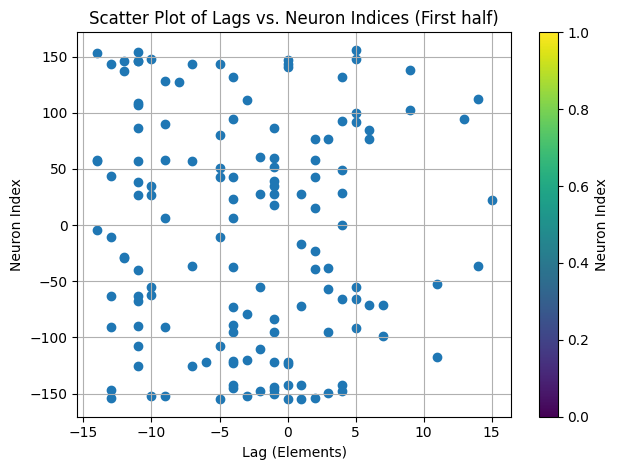

In [108]:
plt.scatter(max_1, max_2)  # Use neuron_indices for colors
plt.xlabel('Lag (Elements)')
plt.ylabel('Neuron Index')
plt.title('Scatter Plot of Lags vs. Neuron Indices (First half)')
plt.colorbar(label='Neuron Index')  # Add a colorbar for reference
plt.grid(True)
plt.tight_layout()
plt.show()

## Histogram Plot

In [109]:
corr, lags = get_correlation_arrays(sum_split_2, filt_split_2)
max_lags_2, rel_neur_2 = sort_lags(corr, lags)

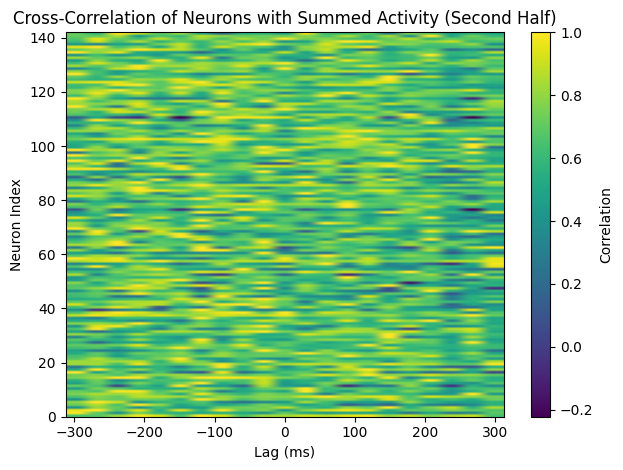

In [110]:
dt = 1/32

corr_full, lags_full = get_correlation_arrays(nord_B, filtered_data,max_lag_seconds=0.32)
lags_full = lags_full * dt * 1000
plt.imshow(corr_full, extent=[lags_full[0][0], lags_full[0][-1], 0, len(corr_full)], aspect='auto', origin = 'lower', cmap='viridis')
plt.xlabel('Lag (ms)')  
plt.ylabel('Neuron Index')
plt.title('Cross-Correlation of Neurons with Summed Activity (Second Half)')
plt.colorbar(label='Correlation')
plt.tight_layout()
plt.show()

### d-lag by neuron

In [111]:
rel_neur_1

array([ 39,  80,  92,  87,  66,  45,  49,  68, 127, 114, 135,  83,  63,
        16,  12,  21,  38,  74, 117,  78,  82,  86,  91,  81,  30,  40,
        62,  41, 141,   9,  96,   1, 126, 134,  58,  52, 123,   5,   4,
        55,  85, 109,   8,  34,  69,  84, 108, 131,   2,  50,  67, 133,
       121,  25, 119,  75,  42,  36,  28,  89,  70,  73, 112,  72, 101,
       140, 132, 104, 115,   0,  19,  61, 125,  33,  54,  76, 102,  79,
       116,  97,  18,  31,  90,  24,  60,  43,  11,  20, 137,  64,  57,
        98, 113,  37, 130, 128, 139,  10,  93,  53,  23, 106, 103,  56,
       122, 118,  59,  71,   7,  51,  13,  77, 138,  22, 136, 129,  17,
        26, 105, 110,  88,  15, 124,  65,  29,   6,   3,  35,  48, 107,
        47, 111,  46,  27, 100,  99,  95,  44, 120,  14,  94,  32])

In [112]:
max_lags_1.shape

(142,)

In [113]:
zp_1 = [[j, i] for i, j in zip(max_lags_1, rel_neur_1)]
zp_2 = [[j, i] for i, j in zip(max_lags_2, rel_neur_2)]

In [114]:
zp_1 = sorted(zp_1, key=lambda x: x[0])
zp_2 = sorted(zp_2, key=lambda x: x[0])

In [115]:
diff_arr = [ i[1] - j[1] for i,j in zip(zp_1, zp_2)]

In [116]:
test = np.diff(frame_t)

In [117]:
frame_t[100:]

array([   4.337,    4.371,    4.404, ..., 1707.1  , 1707.1  , 1707.1  ])

In [118]:
print(zp_1[1][1])
print(zp_2[1][1])

-10.0
-14.0


In [119]:
zp_1[1][1] - zp_2[1][1]

np.float64(4.0)

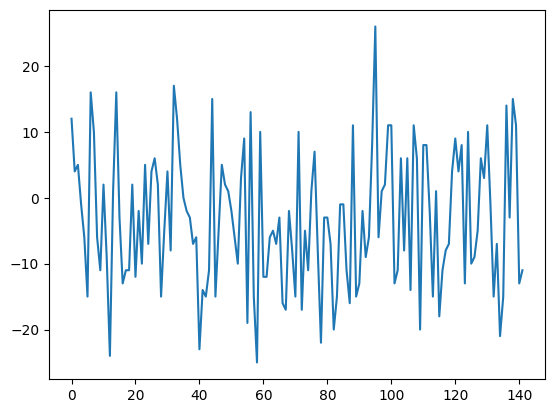

In [120]:
plt.plot(diff_arr)

In [121]:
import numpy as np
from scipy.signal import correlate, correlation_lags

# Example usage (with full arrays):

fs = 1.0/0.035 #Sampling rate

max_lag_seconds = 0.5  # Maximum lag in seconds
max_lag_samples = int(max_lag_seconds * fs)  # Convert to samples

# Assuming 'filtered_data' is your full (142, ~50000) array
# and 'summed_signal' is your full (~50000) summed signal.
print(max_lag_samples)
correlation_neuron = []
lags_neuron = []

for i in range(filtered_data.shape[0]): #Iterate through neurons
    neuron_signal = filtered_data[i,:] #Get individual neuron signal
    corr, lags = limited_cross_correlation(neuron_signal, nord_B, max_lag_samples)

    corr /= np.max(np.abs(corr))  # Normalize

    correlation_neuron.append(corr)
    lags_neuron.append(lags)

correlation_neuron = np.array(correlation_neuron) #Convert to numpy array
lags_neuron = np.array(lags_neuron) #Convert to numpy array

# ... (rest of your analysis - correlation_neuron and lags_neuron are now lists of the correlations and lags for each neuron) ...

14


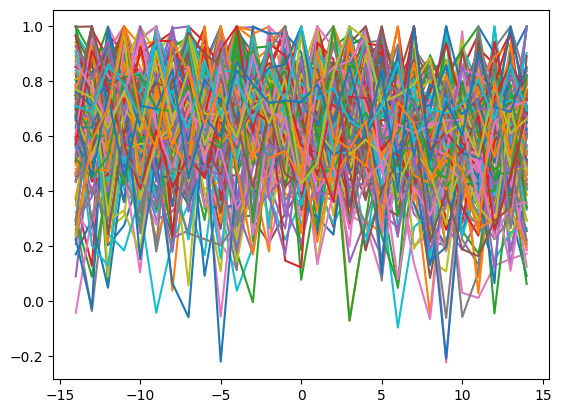

In [122]:
for i, corr in enumerate(correlation_neuron):
    lags = lags_neuron[i]
    plt.plot(lags,corr)

In [123]:
max_lag = []
for i in range(0, len(correlation_neuron)):
    max_lag.append(lags_neuron[i][np.argmax(correlation_neuron[i])])
max_lag.sort()
len(max_lag)    

142

In [124]:
correlation_neuron[1]


array([0.6706098 , 0.9254922 , 0.7609308 , 0.6532087 , 1.        ,
       0.7003811 , 0.39081895, 0.7500588 , 0.5826209 , 0.55379915,
       0.52198577, 0.567969  , 0.50857544, 0.40554446, 0.70193654,
       0.5250561 , 0.43337396, 0.4927219 , 0.49184093, 0.48881304,
       0.24461633, 0.52134603, 0.27111566, 0.35685614, 0.6858902 ,
       0.73049134, 0.25010523, 0.6043892 , 0.4642424 ], dtype=float32)

In [125]:
max_lag[3]

np.int64(-13)

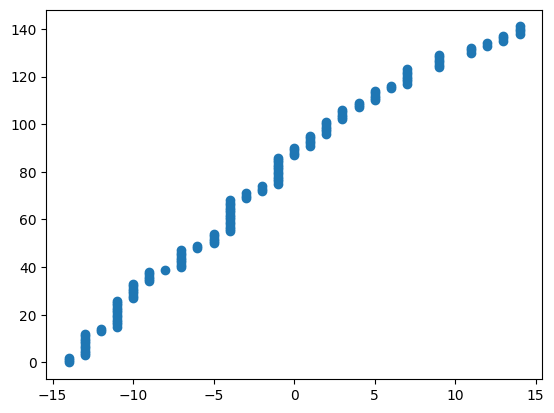

In [126]:
plt.scatter(max_lag, range(0, len(max_lag)))

In [127]:
correlation_neuron = []
lags_neuron = []
for i in filtered_data:
    corr = correlate(i, nord_B)
    lags = correlation_lags(i.size, nord_B.size)
    corr /= np.max(corr)
    correlation_neuron.append(corr)
    lags_neuron.append(lags)

In [128]:
max_lag = []
for i in range(0, len(correlation_neuron)):
    max_lag.append(lags_neuron[i][np.argmax(correlation_neuron[i])])

In [129]:
len(max_lag)

142

In [130]:
max_lag.sort()
len(max_lag)

142

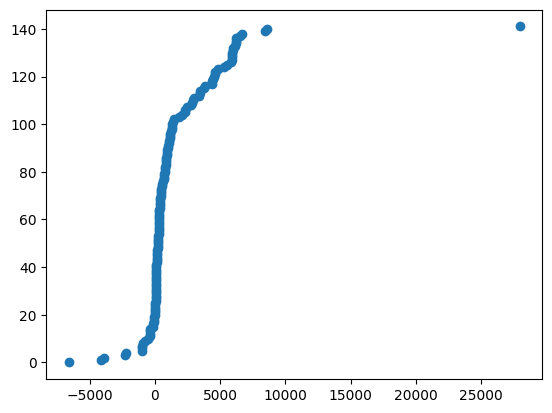

In [131]:
plt.scatter(max_lag, range(0, len(max_lag)))

In [132]:
sample_segment = example['data']
sample_summed = long_sum_segm[2]

correlation_neuron = []
lags_neuron = []
for i in sample_segment:
    corr = correlate(i, sample_summed['data'])
    lags = correlation_lags(i.size, sample_summed['data'].size)
    corr /= np.max(corr)
    correlation_neuron.append(corr)
    lags_neuron.append(lags)